In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import MiniBatchKMeans

In [2]:
corona_df_completo = pd.read_csv('corona_df_completo.csv')
corona_df_completo = corona_df_completo.dropna()

In [3]:
from sklearn.feature_extraction.text import TfidfVectorizer
dataset_texts = corona_df_completo['text'].tolist()
tfidf = TfidfVectorizer(max_features=2**12)
vectorized = tfidf.fit_transform(dataset_texts)

In [4]:
from sklearn.decomposition import PCA
pca = PCA(n_components = 2)
X_pca = pca.fit_transform(vectorized.toarray())

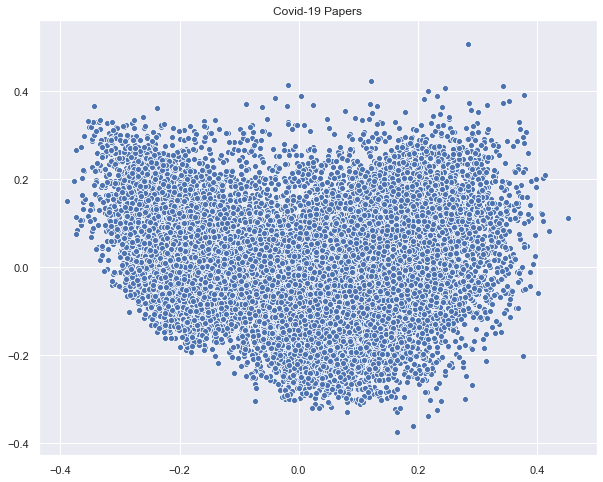

In [5]:
sns.set(rc={'figure.figsize': (10,8)})
sns.scatterplot(X_pca[:,0], X_pca[:, 1])
plt.title('Covid-19 Papers');

In [6]:
k = 5
kmeans = MiniBatchKMeans(n_clusters=k)
y_pred = kmeans.fit_predict(vectorized)

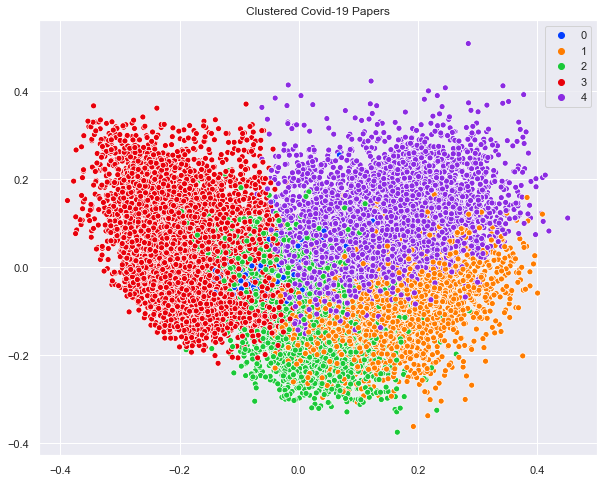

In [7]:
palette = sns.color_palette('bright', len(set(y_pred)))
sns.scatterplot(X_pca[:,0], X_pca[:, 1], hue=y_pred, legend='full', palette=palette)
plt.title('Clustered Covid-19 Papers');

In [8]:
# Based on: https://www.kaggle.com/maksimeren/covid-19-literature-clustering

from bokeh.models import ColumnDataSource, HoverTool, LinearColorMapper, CustomJS
from bokeh.palettes import Category20
from bokeh.transform import linear_cmap
from bokeh.io import output_file, show
from bokeh.transform import transform
from bokeh.io import output_notebook
from bokeh.plotting import figure
from bokeh.layouts import column
from bokeh.models import RadioButtonGroup
from bokeh.models import TextInput
from bokeh.layouts import gridplot
from bokeh.models import Div
from bokeh.models import Paragraph
from bokeh.layouts import column, widgetbox

output_notebook()
y_labels = y_pred

# data sources
source = ColumnDataSource(data=dict(
    x= X_pca[:,0], 
    y= X_pca[:,1],
    x_backup = X_pca[:,0],
    y_backup = X_pca[:,1],
    desc= y_labels, 
    titles= corona_df_completo['title'],
    abstract = corona_df_completo['abstract'],
    labels = ["C-" + str(x) for x in y_labels]
    ))

# hover over information
hover = HoverTool(tooltips=[
    ("Title", "@titles{safe}"),
    ("Abstract", "@abstract{safe}"),
],
                 point_policy="follow_mouse")

# map colors
mapper = linear_cmap(field_name='desc', 
                     palette=Category20[20],
                     low=min(y_labels) ,high=max(y_labels))

# prepare the figure
p = figure(plot_width=800, plot_height=800, 
           tools=[hover, 'pan', 'wheel_zoom', 'box_zoom', 'reset'], 
           title="Covid-19 Papers", 
           toolbar_location="right")

# plot
p.scatter('x', 'y', size=5, 
          source=source,
          fill_color=mapper,
          line_alpha=0.3,
          line_color="black",
          legend = 'labels')

# add callback to control 
callback = CustomJS(args=dict(p=p, source=source), code="""
            
            var radio_value = cb_obj.active;
            var data = source.data; 
            
            x = data['x'];
            y = data['y'];
            
            x_backup = data['x_backup'];
            y_backup = data['y_backup'];
            
            labels = data['desc'];
            
            if (radio_value == '20') {
                for (i = 0; i < x.length; i++) {
                    x[i] = x_backup[i];
                    y[i] = y_backup[i];
                }
            }
            else {
                for (i = 0; i < x.length; i++) {
                    if(labels[i] == radio_value) {
                        x[i] = x_backup[i];
                        y[i] = y_backup[i];
                    } else {
                        x[i] = undefined;
                        y[i] = undefined;
                    }
                }
            }


        source.change.emit();
        """)

# callback for searchbar
keyword_callback = CustomJS(args=dict(p=p, source=source), code="""
            
            var text_value = cb_obj.value;
            var data = source.data; 
            
            x = data['x'];
            y = data['y'];
            
            x_backup = data['x_backup'];
            y_backup = data['y_backup'];
            
            abstract = data['abstract'];
            titles = data['titles'];
            
            for (i = 0; i < x.length; i++) {
                if(abstract[i].includes(text_value) || 
                   titles[i].includes(text_value)  {
                    x[i] = x_backup[i];
                    y[i] = y_backup[i];
                } else {
                    x[i] = undefined;
                    y[i] = undefined;
                }
            }
        source.change.emit();
        """)

# option
option = RadioButtonGroup(labels=["C-0", "C-1", "C-2",
                                  "C-3", "C-4", "All"], 
                          active=20, callback=callback)

# search box
keyword = TextInput(title="Search:", callback=keyword_callback)

#header
header = Div(text="""<h1>Covid-19 Papers</h1>""")

# show
show(column(header, widgetbox(option, keyword),p))

Loading BokehJS ...